# Часть 1 Бустинг (5 баллов)

В этой части будем предсказывать зарплату data scientist-ов в зависимости  от ряда факторов с помощью градиентного бустинга.

В датасете есть следующие признаки:



* work_year: The number of years of work experience in the field of data science.

* experience_level: The level of experience, such as Junior, Senior, or Lead.

* employment_type: The type of employment, such as Full-time or Contract.

* job_title: The specific job title or role, such as Data Analyst or Data Scientist.

* salary: The salary amount for the given job.

* salary_currency: The currency in which the salary is denoted.

* salary_in_usd: The equivalent salary amount converted to US dollars (USD) for comparison purposes.

* employee_residence: The country or region where the employee resides.

* remote_ratio: The percentage of remote work offered in the job.

* company_location: The location of the company or organization.

* company_size: The company's size is categorized as Small, Medium, or Large.

In [70]:
import numpy as np
import pandas as pd

df = pd.read_csv("ds_salaries.csv")
df.head()

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size
0,2023,SE,FT,Principal Data Scientist,80000,EUR,85847,ES,100,ES,L
1,2023,MI,CT,ML Engineer,30000,USD,30000,US,100,US,S
2,2023,MI,CT,ML Engineer,25500,USD,25500,US,100,US,S
3,2023,SE,FT,Data Scientist,175000,USD,175000,CA,100,CA,M
4,2023,SE,FT,Data Scientist,120000,USD,120000,CA,100,CA,M


## Задание 1 (0.5 балла) Подготовка



*   Разделите выборку на train, val, test (80%, 10%, 10%)
*   Выдерите salary_in_usd в качестве таргета
*   Найдите и удалите признак, из-за которого возможен лик в данных


In [71]:
from sklearn.model_selection import train_test_split
#Признак, их-за которого возможен лик - salary, так как он тот же таргет, только в разных валютах
df = df.drop("salary", axis=1)
train, test = train_test_split(df, test_size=0.1, random_state=42)
train, val = train_test_split(train, test_size=1/9, random_state=42)
X_train, X_val, X_test, y_train, y_val, y_test = train.drop('salary_in_usd', axis=1), val.drop('salary_in_usd', axis=1), test.drop('salary_in_usd', axis=1), train['salary_in_usd'], val['salary_in_usd'], test['salary_in_usd']


## Задание 2 (0.5 балла) Линейная модель


*   Закодируйте категориальные  признаки с помощью OneHotEncoder
*   Обучите модель линейной регрессии
*   Оцените  качество через MAPE и RMSE


In [72]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error
from sklearn.preprocessing import OneHotEncoder

categorical_features = ['experience_level', 'employment_type', 'job_title', 'salary_currency', 'employee_residence', 'company_location', 'company_size']

encoder = OneHotEncoder(sparse_output=False, handle_unknown="ignore")
encoder.fit(df[categorical_features])
X_train = pd.concat([X_train, pd.DataFrame(encoder.transform(X_train[categorical_features]), columns=encoder.get_feature_names_out(), index=X_train.index)], axis=1).reset_index(drop=True)
X_train = X_train.drop(columns=categorical_features)

X_val = pd.concat([X_val, pd.DataFrame(encoder.transform(X_val[categorical_features]), columns=encoder.get_feature_names_out(), index=X_val.index)], axis=1).reset_index(drop=True)
X_val = X_val.drop(columns=categorical_features)

X_test = pd.concat([X_test, pd.DataFrame(encoder.transform(X_test[categorical_features]), columns=encoder.get_feature_names_out(), index=X_test.index)], axis=1).reset_index(drop=True)
X_test = X_test.drop(columns=categorical_features)

linregr = LinearRegression().fit(X_train, y_train)
y_pred = linregr.predict(X_test)
print('MAPE: ', mean_absolute_percentage_error(y_test, y_pred))
print('RMSE: ', np.sqrt(mean_squared_error(y_test, y_pred)))

MAPE:  0.45326280689808757
RMSE:  51637.41420358057


## Задание 3 (0.5 балла) XGboost

Начнем с библиотеки xgboost.

Обучите модель `XGBRegressor` на тех же данных, что линейную модель, подобрав оптимальные гиперпараметры (`max_depth, learning_rate, n_estimators, gamma`, etc.) по валидационной выборке. Оцените качество итоговой модели (MAPE, RMSE), скорость обучения и скорость предсказания.

In [73]:
from xgboost.sklearn import XGBRegressor
import time

params = {
    'max_depth': np.arange(4, 9, 1),
    'learning_rate': np.arange(0.01, 0.05, 0.01),
    'n_estimators': np.arange(100, 301, 50),
    'gamma': np.arange(0, 0.5, 0.1),
}
best_md, best_lr, best_n, best_g, rmse_best = 0, 0, 0, 0, float('inf')
start = time.time()
for md in params['max_depth']:
  for lr in params['learning_rate']:
    for n in params['n_estimators']:
      for g in params['gamma']:
        xgbrgr = XGBRegressor(max_depth=md, learning_rate=lr, n_estimators=n, gamma=g, random_state=42).fit(X_train, y_train)
        rmse = np.sqrt(mean_squared_error(y_val, xgbrgr.predict(X_val)))
        if rmse < rmse_best:
          best_md, best_lr, best_n, best_g, rmse_best = md, lr, n, g, rmse
end = time.time()
print(f"Время подбора: {end - start} секунд")


Время подбора: 459.1083879470825 секунд


In [74]:
xgbrgr = XGBRegressor(max_depth=best_md, learning_rate=best_lr, n_estimators=best_n, gamma=best_g, random_state=42).fit(X_train, y_train)
print('MAPE: ', mean_absolute_percentage_error(y_test, xgbrgr.predict(X_test)))
print('RMSE: ', np.sqrt(mean_squared_error(y_test, xgbrgr.predict(X_test))))

MAPE:  0.37925559282302856
RMSE:  49774.28733794187


## Задание 4 (1 балл) CatBoost

Теперь библиотека CatBoost.

Обучите модель `CatBoostRegressor`, подобрав оптимальные гиперпараметры (`depth, learning_rate, iterations`, etc.) по валидационной выборке. Оцените качество итоговой модели (MAPE, RMSE), скорость обучения и скорость предсказания.

In [7]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 9.7 MB/s eta 0:00:00


In [75]:
from catboost import CatBoostRegressor

params = {
    'depth': np.arange(9, 12, 1),
    'learning_rate': np.arange(0.001, 0.2, 0.02),
    'iterations': np.arange(50, 300, 50),
}

best_d, best_lr, best_n, rmse_best = 0, 0, 0, float('inf')
start = time.time()
for d in params['depth']:
  for lr in params['learning_rate']:
    for n in params['iterations']:
        catbrgr = CatBoostRegressor(depth=d, learning_rate=lr, iterations=n, random_state=42, silent=True).fit(X_train, y_train)
        rmse = np.sqrt(mean_squared_error(y_val, catbrgr.predict(X_val)))
        if rmse < rmse_best: best_d, best_lr, best_n, rmse_best = md, lr, n, rmse
end = time.time()
print(f"Время подбора: {end - start} секунд")

Время подбора: 232.60169315338135 секунд


In [76]:
catbrgr = CatBoostRegressor(depth=best_d, learning_rate=best_lr, iterations=best_n, random_state=42, silent=True).fit(X_train, y_train)

print('MAPE: ', mean_absolute_percentage_error(y_test, catbrgr.predict(X_test)))
print('RMSE: ', np.sqrt(mean_squared_error(y_test, catbrgr.predict(X_test))))

MAPE:  0.3997996740153587
RMSE:  49637.27026100124


Для применения catboost моделей не обязательно сначала кодировать категориальные признаки, модель может кодировать их сама. Обучите catboost с подбором оптимальных гиперпараметров снова, используя pool для передачи данных в модель с указанием какие признаки категориальные, а какие нет с помощью параметра cat_features. Оцените качество и время. Стало ли лучше?

In [77]:
from catboost import Pool

from catboost import CatBoostRegressor

params = {
    'depth': np.arange(9, 12, 1),
    'learning_rate': np.arange(0.001, 0.2, 0.02),
    'iterations': np.arange(50, 300, 50),
}

best_d, best_lr, best_n, rmse_best = 0, 0, 0, float('inf')
train_pool = Pool(df.iloc[X_train.index].drop('salary_in_usd', axis=1), y_train, cat_features=categorical_features)
val_pool = Pool(df.iloc[X_val.index].drop('salary_in_usd', axis=1), y_val, cat_features=categorical_features)
test_pool = Pool(df.iloc[X_test.index].drop('salary_in_usd', axis=1), y_test, cat_features=categorical_features)
start = time.time()
for d in params['depth']:
  for lr in params['learning_rate']:
    for n in params['iterations']:
        catbrgr = CatBoostRegressor(depth=d, learning_rate=lr, iterations=n, random_seed=42, silent=True).fit(train_pool)
        rmse = np.sqrt(mean_squared_error(y_val, catbrgr.predict(val_pool)))
        if rmse < rmse_best: best_d, best_lr, best_n, rmse_best = d, lr, n, rmse
end = time.time()
print(f"Время подбора: {end - start} секунд")
print('MAPE: ', mean_absolute_percentage_error(y_test, catbrgr.predict(test_pool)))
print('RMSE: ', np.sqrt(mean_squared_error(y_test, catbrgr.predict(test_pool))))

Время подбора: 560.3623096942902 секунд
MAPE:  0.866191568512925
RMSE:  67493.08339620566


**Ответ:** Качество ухудшилось

## Задание 5 (0.5 балла) LightGBM

И наконец библиотека LightGBM - используйте `LGBMRegressor`, снова подберите гиперпараметры, оцените качество и скорость.


In [78]:
from lightgbm import LGBMRegressor

params = {
    'max_depth' : np.arange(1, 10, 1),
    'learning_rate' : np.arange(0.001, 0.2, 0.02),
    'n_estimators' : np.arange(50, 351, 50),
}

best_d, best_lr, best_n, rmse_best = 0, 0, 0, float('inf')
start = time.time()
for d in params['max_depth']:
  for lr in params['learning_rate']:
    for n in params['n_estimators']:
        lgbregr = LGBMRegressor(max_depth=d, learning_rate=lr, n_estimators=n, random_state=42, n_jobs=-1, verbosity=-1).fit(X_train, y_train)
        rmse = np.sqrt(mean_squared_error(y_val, lgbregr.predict(X_val)))
        if rmse < rmse_best: best_d, best_lr, best_n, rmse_best = d, lr, n, rmse
end = time.time()
print(f"Время подбора: {end - start} секунд")

Время подбора: 71.0957989692688 секунд


In [79]:
lgbregr = LGBMRegressor(max_depth=best_d, learning_rate=best_lr, n_estimators=best_n, random_state=42, n_jobs=-1, verbosity=-1).fit(X_train, y_train)

print('MAPE: ', mean_absolute_percentage_error(y_test, lgbregr.predict(X_test)))
print('RMSE: ', np.sqrt(mean_squared_error(y_test, lgbregr.predict(X_test))))

MAPE:  0.4098102066264388
RMSE:  51008.18032234287


## Задание 6 (2 балла) Сравнение и выводы

Сравните модели бустинга и сделайте про них выводы, какая из моделей показала лучший/худший результат по качеству, скорости обучения и скорости предсказания? Как отличаются гиперпараметры для разных моделей?

**Ответ:** Итак, мы имеем: LinearRegression: MAPE:  0.45326280689808757 RMSE: 51637.41420358057. Время меньше минуты.
XGBRegressor: Время подбора: 459.1083879470825 секунд. MAPE:  0.37925559282302856
RMSE:  49774.28733794187.
CatBoostRegressor: Время подбора: 232.60169315338135 секунд. MAPE:  0.3997996740153587
RMSE:  49637.27026100124.
CatBoostRegressor + Pool: Время подбора: 560.3623096942902 секунд
MAPE:  0.866191568512925
RMSE:  67493.08339620566.
LGBMRegressor: Время подбора: 71.0957989692688 секунд. MAPE:  0.4098102066264388
RMSE:  51008.18032234287


Вывод: Лучшей моделью по качеству оказалась XGBRegressor. Работает достаточно долго

# Часть 2 Кластеризация (5 баллов)

Будем работать с данными о том, каких исполнителей слушают пользователи музыкального сервиса.

Каждая строка таблицы - информация об одном пользователе. Каждый столбец - это исполнитель (The Beatles, Radiohead, etc.)

Для каждой пары (пользователь, исполнитель) в таблице стоит число - доля прослушивания этого исполнителя этим пользователем.


In [43]:
import pandas as pd
ratings = pd.read_excel("https://github.com/evgpat/edu_stepik_rec_sys/blob/main/datasets/sample_matrix.xlsx?raw=true", engine='openpyxl')
ratings.head()

,user,the beatles,radiohead,deathcab for cutie,coldplay,modest mouse,sufjan stevens,dylan. bob,red hot clili peppers,pink fluid,...,municipal waste,townes van zandt,curtis mayfield,jewel,lamb,michal w. smith,群星,agalloch,meshuggah,yellowcard
0,0,NaN,0.020417,NaN,NaN,NaN,NaN,NaN,0.030496,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,NaN,0.184962,0.024561,NaN,NaN,0.136341,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,NaN,NaN,0.028635,NaN,NaN,NaN,0.024559,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,0.043529,0.086281,0.034590,0.016712,0.015935,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Будем строить кластеризацию исполнителей: если двух исполнителей слушало много людей примерно одинаковую долю своего времени (то есть векторы близки в пространстве), то, возможно исполнители похожи. Эта информация может быть полезна при построении рекомендательных систем.

## Задание 1 (0.5 балла) Подготовка

Транспонируем матрицу ratings, чтобы по строкам стояли исполнители.

In [44]:
ratings = ratings.T

Выкиньте строку под названием `user`.

In [45]:
ratings = ratings.drop('user', axis=0)

В таблице много пропусков, так как пользователи слушают не всех-всех исполнителей, чья музыка представлена в сервисе, а некоторое подмножество (обычно около 30 исполнителей)


Доля исполнителя в музыке, прослушанной  пользователем, равна 0, если пользователь никогда не слушал музыку данного музыканта, поэтому заполните пропуски нулями.



In [46]:
ratings = ratings.fillna(0)
ratings.sample()

,0,1,2,3,4,5,6,7,8,9,...,4990,4991,4992,4993,4994,4995,4996,4997,4998,4999
mf doom,0.0,0.0,0.0,0.0,0.0,0.0,0.055286,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Задание 2 (0.5 балла) Первая кластеризация

Примените KMeans с 5ю кластерами, сохраните полученные лейблы

In [47]:
from sklearn.cluster import KMeans

kmean = KMeans(n_clusters=5, random_state=42).fit(ratings)
labels = kmean.labels_

Выведите размеры кластеров. Полезной ли получилась кластеризация? Почему KMeans может выдать такой результат?

In [48]:
pd.value_counts(labels)

/tmp/ipython-input-48-2812286946.py:1: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  pd.value_counts(labels)


,count
3,882
0,115
4,1
2,1
1,1


**Ответ:** Кластеризация получилась бесполезной, потому что у нас получилось пять кластеров, таких что один кластер имеет в себе 88 процентов всех объектов, второй 11 процентов, а остальные три кластера и вовсе по одному объекту. KMeans может выдать такой результат, потому что данные плохо масштабированы, из-за чего получилось неравномерное распределение объектов



## Задание 3 (0.5 балла) Объяснение результатов

При кластеризации получилось $\geq 1$ кластера размера 1. Выведите исполнителей, которые составляют такие кластеры. Среди них должна быть группа The Beatles.

In [49]:
ratings[(labels == 1) | (labels == 2) | (labels == 4)]

,0,1,2,3,4,5,6,7,8,9,...,4990,4991,4992,4993,4994,4995,4996,4997,4998,4999
the beatles,0.0,0.0,0.0,0.0,0.043529,0.0,0.0,0.0,0.093398,0.017621,...,0.0,0.0,0.121169,0.038168,0.007939,0.017884,0.0,0.076923,0.0,0.0
niИ,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.012281,...,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0
日dir en grey,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0


Изучите данные, почему именно The Beatles выделяется?

Подсказка: посмотрите на долю пользователей, которые слушают каждого исполнителя, среднюю долю прослушивания.

In [50]:
ratings.mean(axis=1)

,0
the beatles,0.018369
radiohead,0.011851
deathcab for cutie,0.006543
coldplay,0.006030
modest mouse,0.005876
...,...
michal w. smith,0.000895
群星,0.000519
agalloch,0.000997
meshuggah,0.000431


**Ответ:** The beatles выделяются тем, что они являются самыми прослушиваемыми

## Задание 4 (0.5 балла) Улучшение кластеризации

Попытаемся избавиться от этой проблемы: нормализуйте данные при помощи `normalize`.

In [51]:
from sklearn.preprocessing import normalize

normilized_ratings = normalize(ratings)

Примените KMeans с 5ю кластерами на преобразованной матрице, посмотрите на их размеры. Стало ли лучше? Может ли кластеризация быть полезной теперь?

In [52]:
kmean = KMeans(n_clusters=5, random_state=42).fit(normilized_ratings)
labels = kmean.labels_
pd.value_counts(labels)

/tmp/ipython-input-52-4002872814.py:3: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  pd.value_counts(labels)


,count
4,486
1,162
3,140
2,133
0,79


**Ответ** Теперь стало намного лучше, такая кластеризация может быть полезной, так как теперь размеры кластеров не отличаются так сильно в пропорции.

## Задание 5 (1 балл) Центроиды

Выведите для каждого кластера названия топ-10 исполнителей, ближайших к центроиду по косинусной мере. Проинтерпретируйте результат. Что можно сказать о смысле кластеров?

In [53]:
from scipy.spatial.distance import cosine

centroids = kmean.cluster_centers_
for cluster in pd.unique(labels): print(ratings[labels == cluster].apply(lambda x: cosine(x, centroids[cluster]), axis=1).sort_values().head(10), "\n")

the beatles            0.620316
the rolling stones     0.623515
dylan. bob             0.656529
who                    0.698215
led zeppelin.          0.707519
miles davis.           0.720636
simon and garfunkel    0.727295
young, neil            0.731910
pink fluid             0.732046
velvet underground     0.744756
dtype: float64 

radiohead              0.589214
the arcade fire        0.670243
the shins              0.695119
sufjan stevens         0.696286
belle and sebastian    0.706782
broken social scene    0.707001
the pixies             0.707969
animal collective      0.714135
modest mouse           0.720852
spoon                  0.722582
dtype: float64 

fall out boy                 0.634882
the all-americian rejects    0.655979
paramore                     0.658733
kelly clarkson               0.664350
john mayer                   0.674993
the fray                     0.675170
maroon5                      0.688339
dashboard confesssional      0.690969
somethings corporate  

**Ответ:** Исполнители в каждом класетере объединены жанром музыки, предпоследний кластер состоит преимущественно из чернокожих реперов. Поэтому кластеры несут в себе смысл.

## Задание 6 (1 балл) Визуализация

Хотелось бы как-то визуализировать полученную кластеризацию. Постройте точечные графики `plt.scatter` для нескольких пар признаков исполнителей, покрасив точки в цвета кластеров. Почему визуализации получились такими? Хорошо ли они отражают разделение на кластеры? Почему?

/tmp/ipython-input-54-853629444.py:6: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


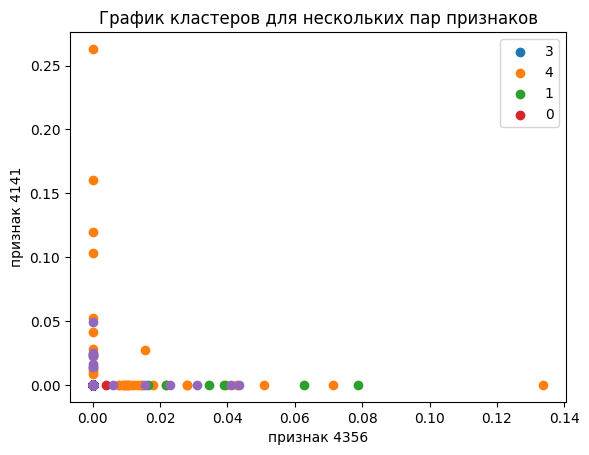

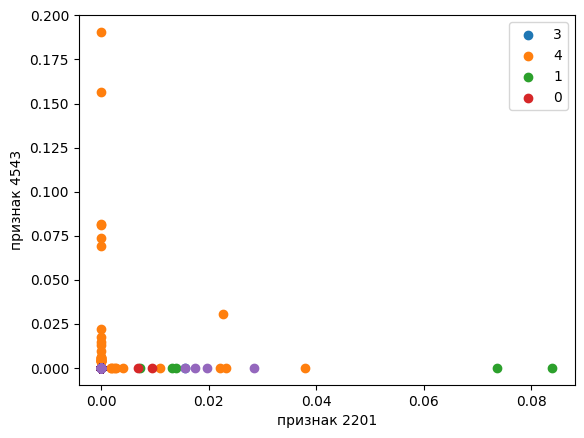

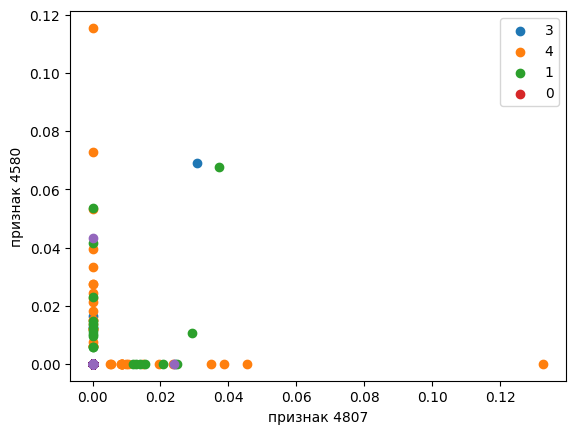

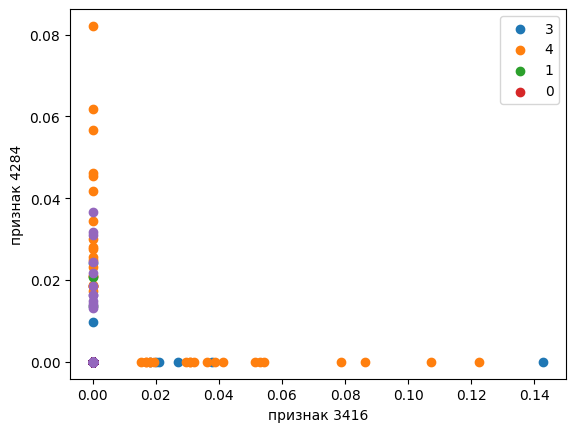

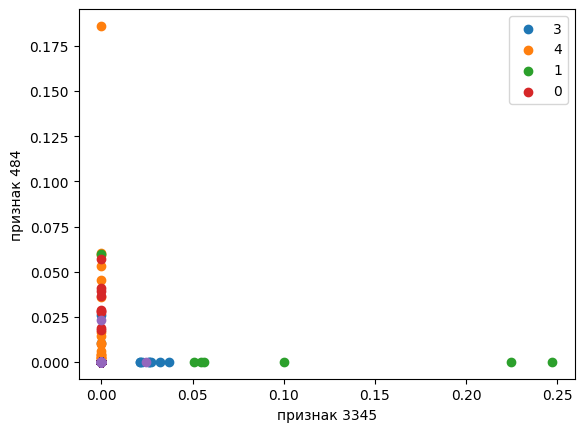

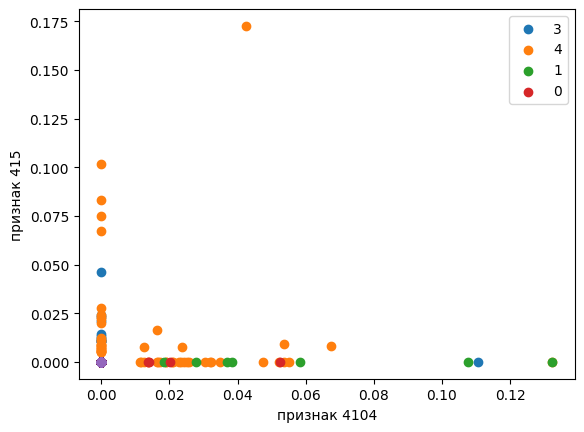

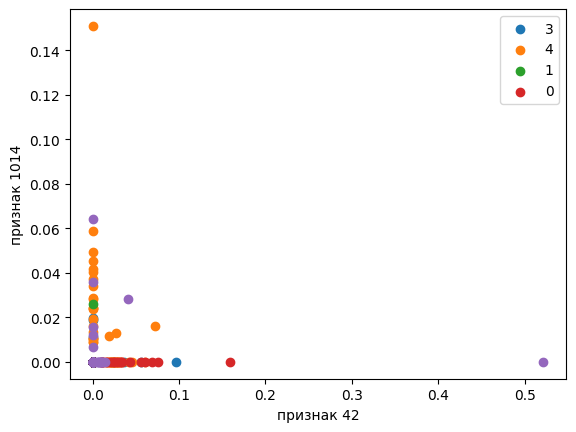

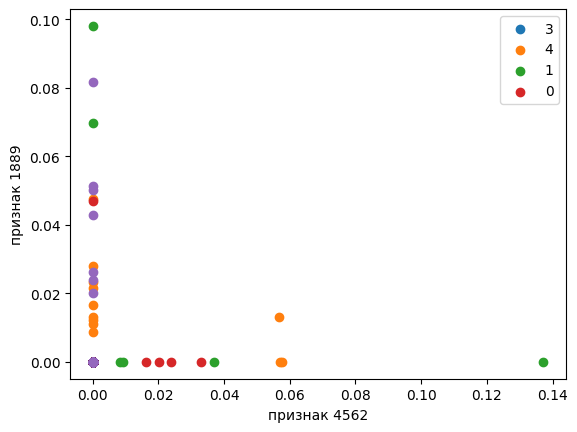

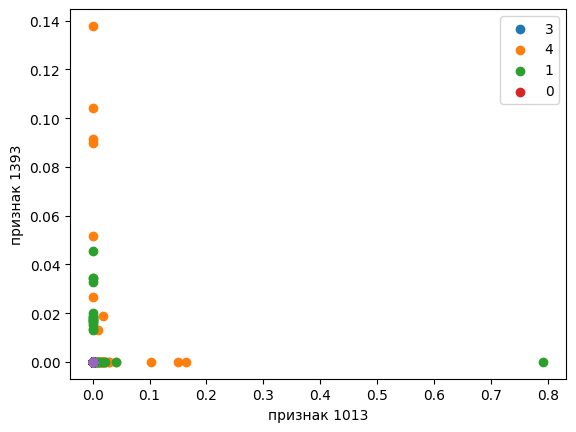

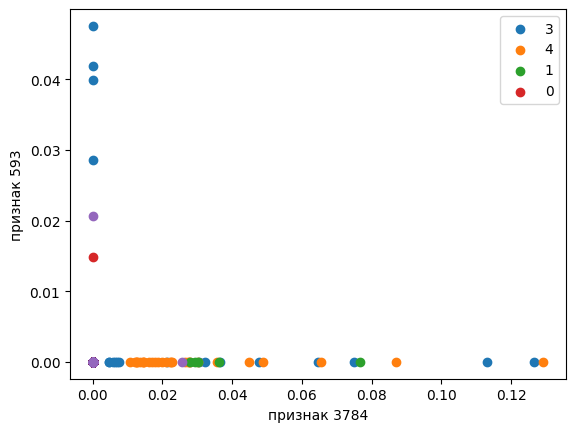

In [54]:
import matplotlib.pyplot as plt
plt.title("График кластеров для нескольких пар признаков")
n_scatters = 10
for i in range(n_scatters):
  for cluster in pd.unique(labels):
    plt.legend()
    x, y = int(np.random.rand()*5000), int(np.random.rand()*5000)
    plt.xlabel(f'признак {x}')
    plt.ylabel(f'признак {y}')
    plt.scatter(ratings[labels==cluster][x], ratings[labels==cluster][y], label=cluster)
  plt.show()

**Ответ:** На графиках плохо видно разделение, так как пространство 5000ное и на двух признаках разделение увидеть не получится. Из-за частых нулей почти все графики получились такими, что точки прижаты к осям.

Для визуализации данных высокой размерности существует метод t-SNE (стохастическое вложение соседей с t-распределением). Данный метод является нелинейным методом снижения размерности: каждый объект высокой размерности будет моделироваться объектов более низкой (например, 2) размерности таким образом, чтобы похожие объекты моделировались близкими, непохожие - далекими с большой вероятностью.

Примените `TSNE` из библиотеки `sklearn` и визуализируйте полученные объекты, покрасив их в цвета их кластеров

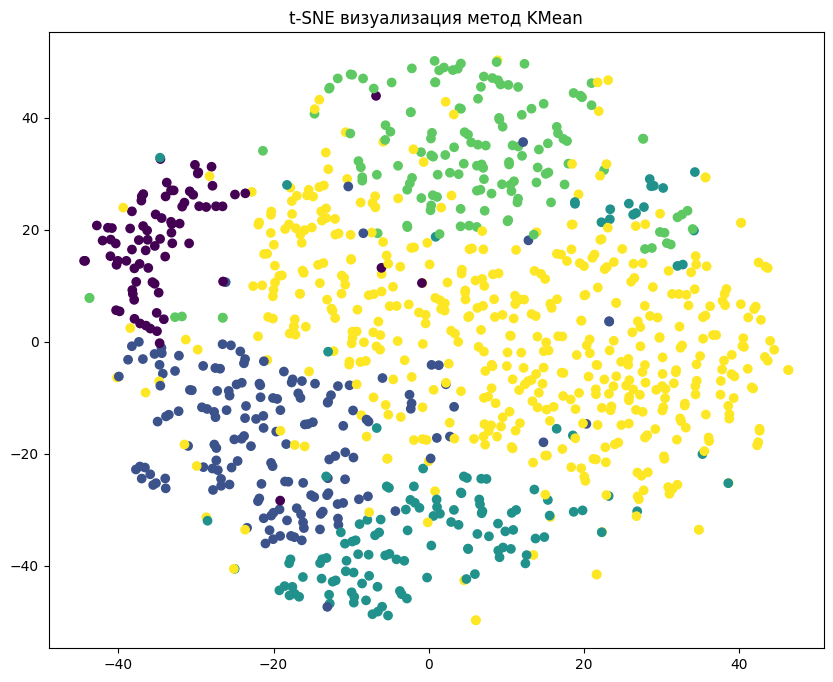

In [57]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
ratings_tsne = tsne.fit_transform(normilized_ratings)

plt.figure(figsize=(10, 8))
plt.scatter(ratings_tsne[:, 0], ratings_tsne[:, 1], c=labels)
plt.title('t-SNE визуализация метод KMean')
plt.show()

## Задание 7 (1 балл) Подбор гиперпараметров

Подберите оптимальное количество кластеров (максимум 100 кластеров) с использованием индекса Силуэта. Зафиксируйте `random_state=42`

In [58]:
from sklearn.metrics import silhouette_score

best_k, best_score = 0, -float('inf')
for k in range(2,101):
    k_means = KMeans(n_clusters=k, random_state=42).fit(normilized_ratings)
    clusters = k_means.predict(normilized_ratings)
    score = silhouette_score(X=normilized_ratings, labels=clusters)
    if score > best_score: best_score, best_k = score, k
print(f'Оптимальное кол-во класетров {best_k} с индексом Силуэта: {best_score}')

Оптимальное кол-во класетров 98 с индексом Силуэта: 0.01332710844154191


Выведите исполнителей, ближайших с центроидам (аналогично заданию 5). Как соотносятся результаты? Остался ли смысл кластеров прежним? Расскажите про смысл 1-2 интересных кластеров, если он изменился и кластеров слишком много, чтобы рассказать про все.

In [61]:
k_means = KMeans(n_clusters=best_k, random_state=42).fit(normilized_ratings)
labels = k_means.labels_
centroids = k_means.cluster_centers_
for cluster in pd.unique(labels): print(ratings[labels == cluster].apply(lambda x: cosine(x, centroids[cluster]), axis=1).sort_values().head(10), "\n")

dylan. bob                    0.457543
the rolling stones            0.540192
young, neil                   0.565998
the beatles                   0.589935
the gateful dead              0.602668
bruce springsteen             0.662568
velvet underground            0.664040
van morrison                  0.668249
the band                      0.672234
creedence clearwater rival    0.682982
dtype: float64 

sigur rós                       0.486819
mogwai                          0.569634
explosions in the sky           0.585665
do make say think               0.602231
radiohead                       0.603610
godspeed you!, black emperor    0.628028
the album leaf                  0.630454
m83                             0.649030
eluvium                         0.656327
múm                             0.661912
dtype: float64 

sufjan stevens         0.471834
the arcade fire        0.551591
the shins              0.563853
beirut                 0.581644
ironand wine           0.595686
andrew

**Ответ:** Оптимальное число кластеров сильно увеличилось. 6ой кластер интересен тем, что он сочетает в себе исполнителей жанров R&B и HIP-HOP, все они популярны, есть как молодые, так и взрослые. Смысл кластеров остался плюс минус прежним, теперь появилась возможность выделить более неявные паттерны разибения.

Сделайте t-SNE визуализацию полученной кластеризации.

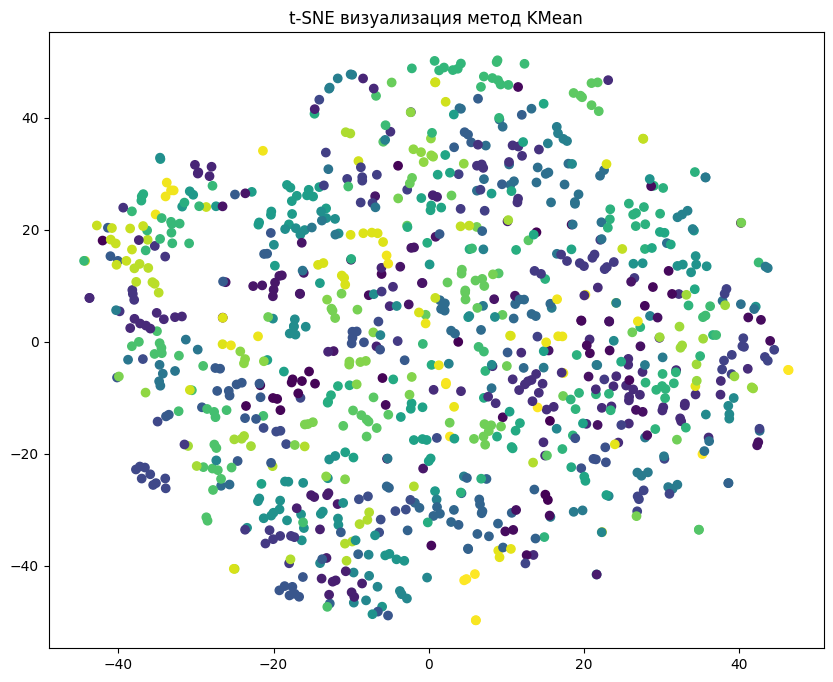

In [62]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
ratings_tsne = tsne.fit_transform(normilized_ratings)

plt.figure(figsize=(10, 8))
plt.scatter(ratings_tsne[:, 0], ratings_tsne[:, 1], c=labels)
plt.title('t-SNE визуализация метод KMean')
plt.show()

Если кластеров получилось слишком много и визуально цвета плохо отличаются, покрасьте только какой-нибудь интересный кластер из задания выше (`c = (labels == i)`). Хорошо ли этот кластер отражается в визуализации?

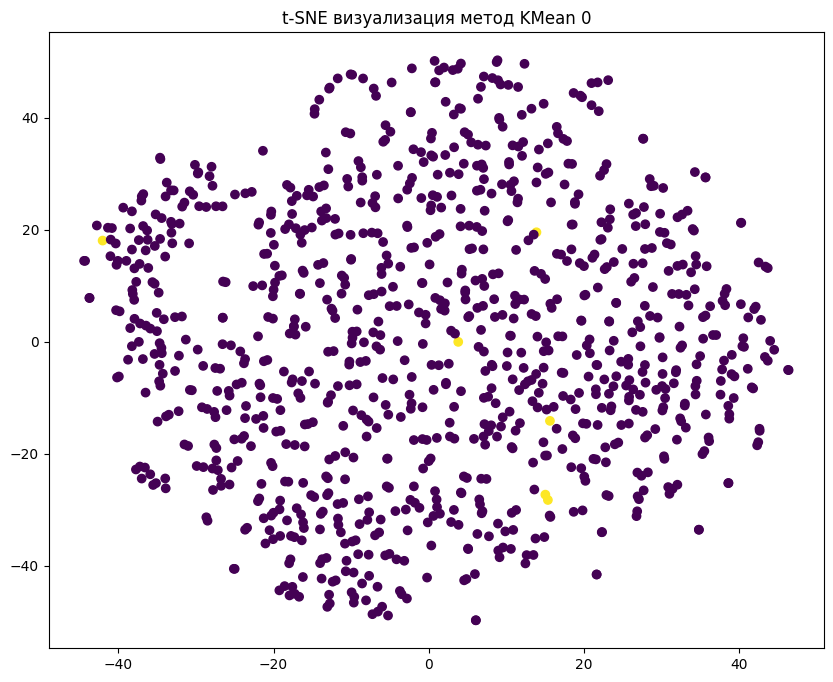

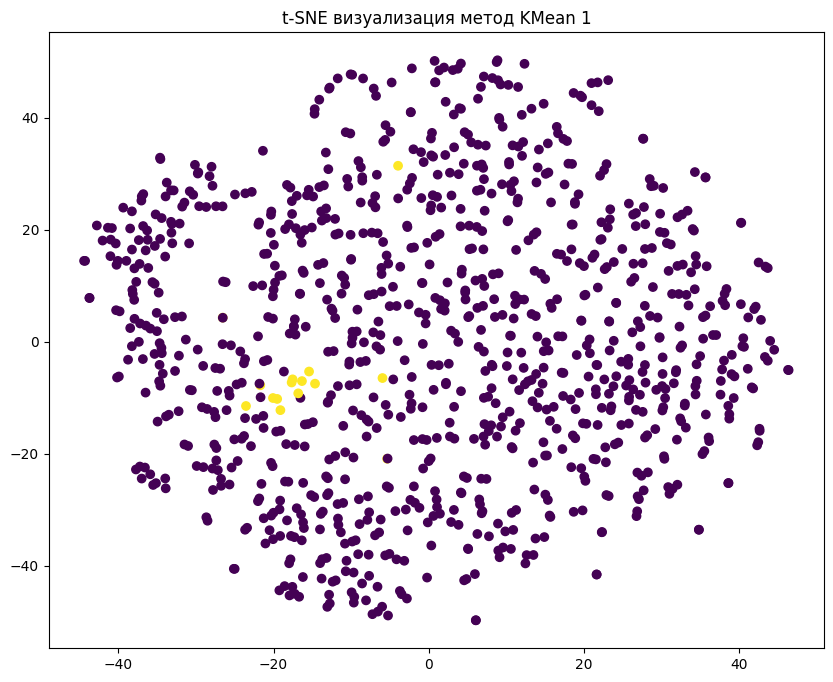

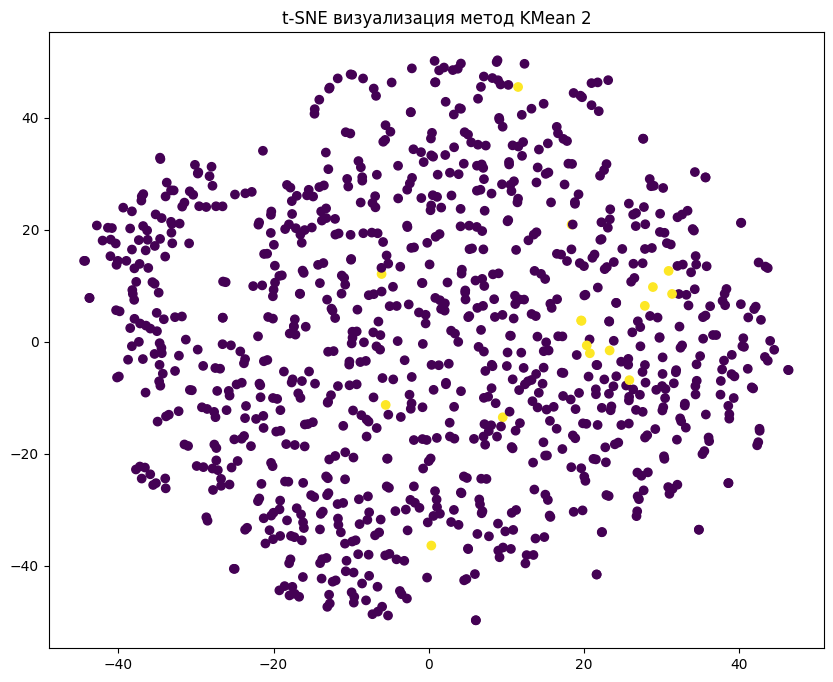

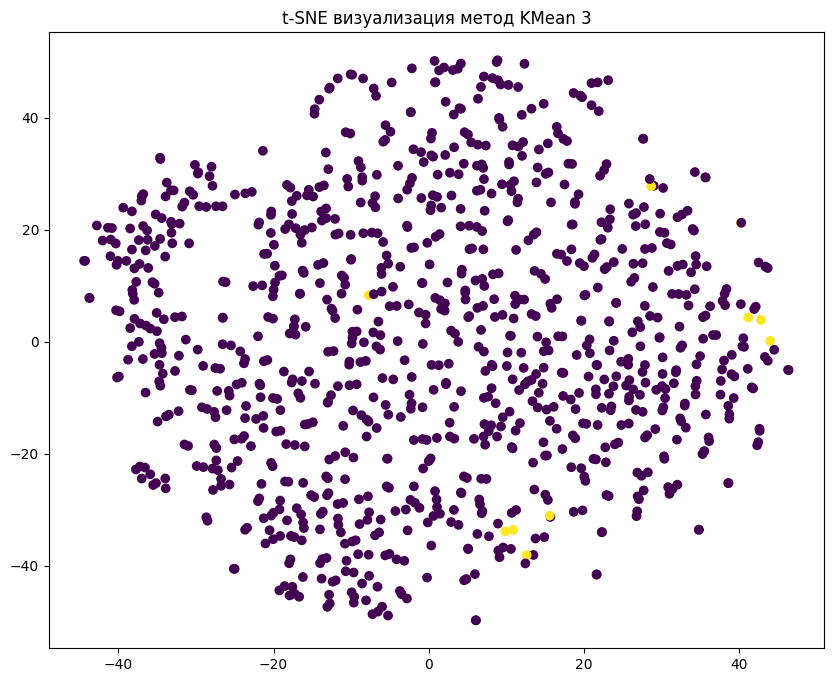

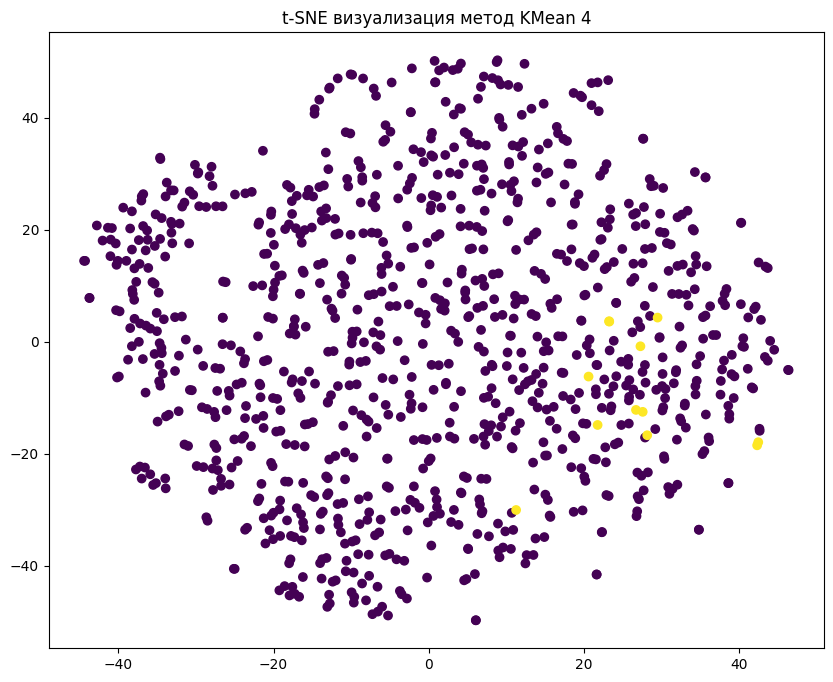

...

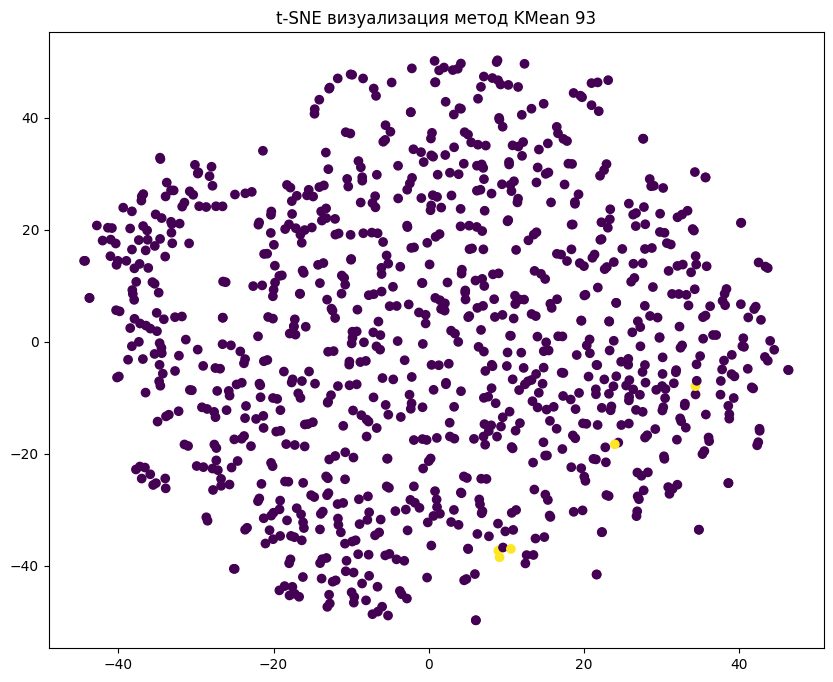

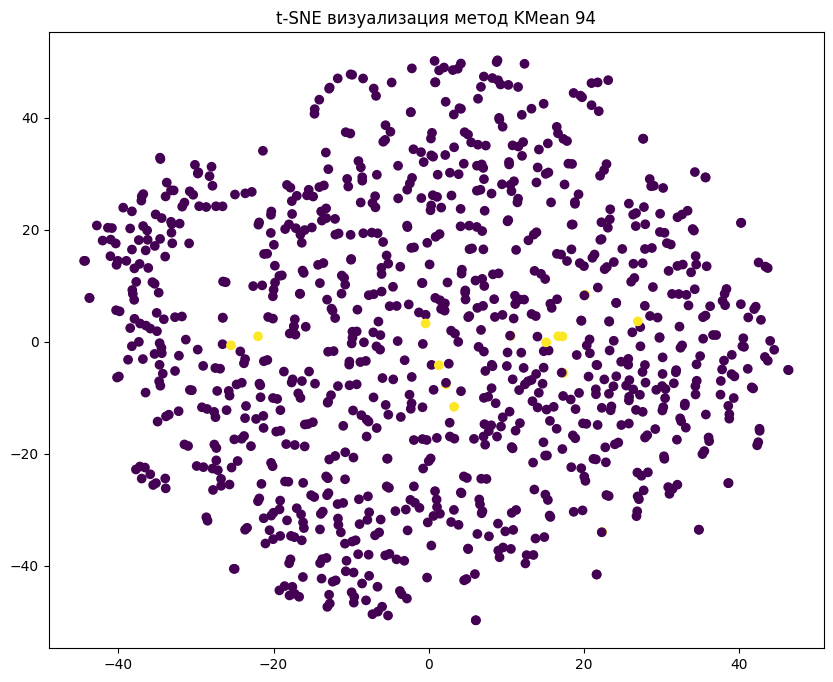

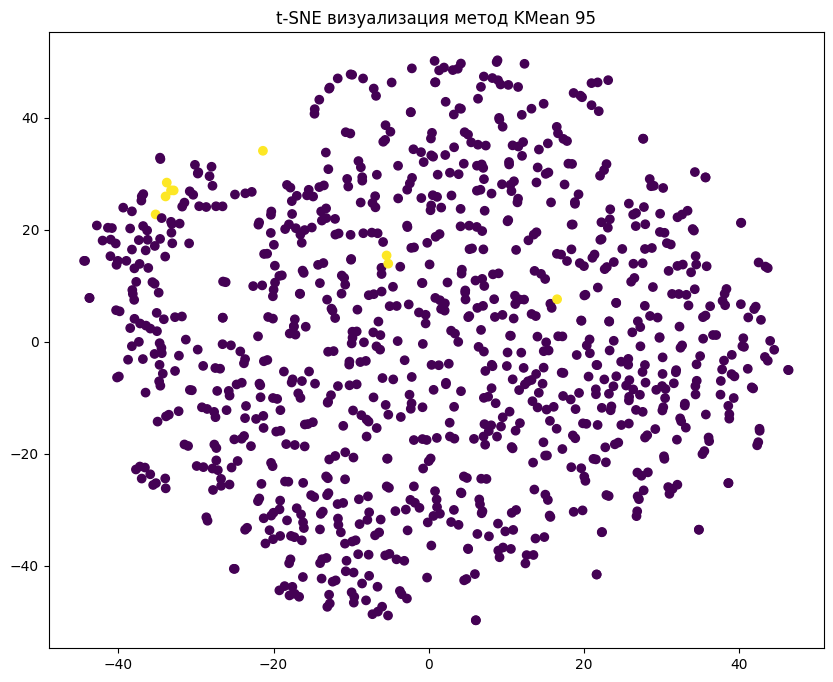

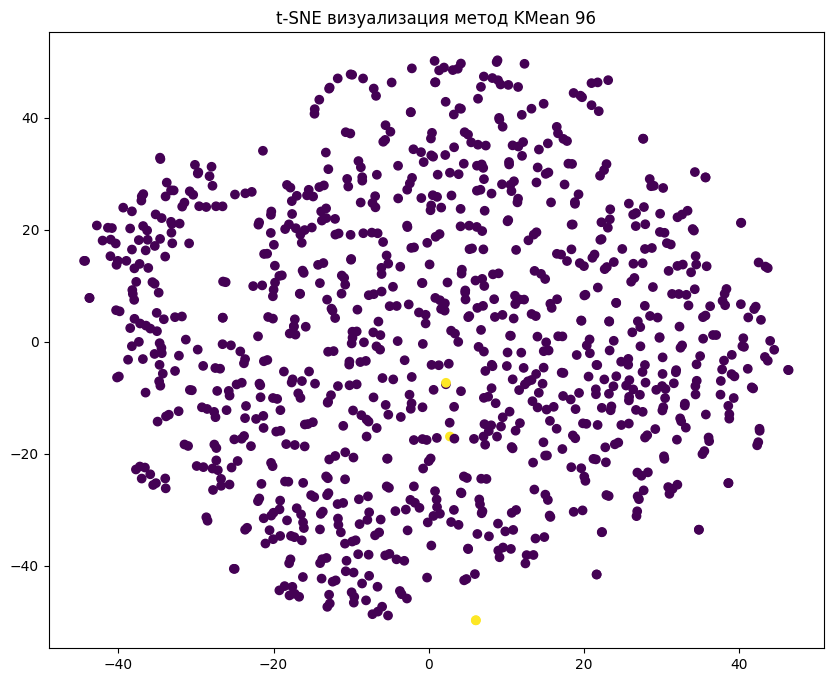

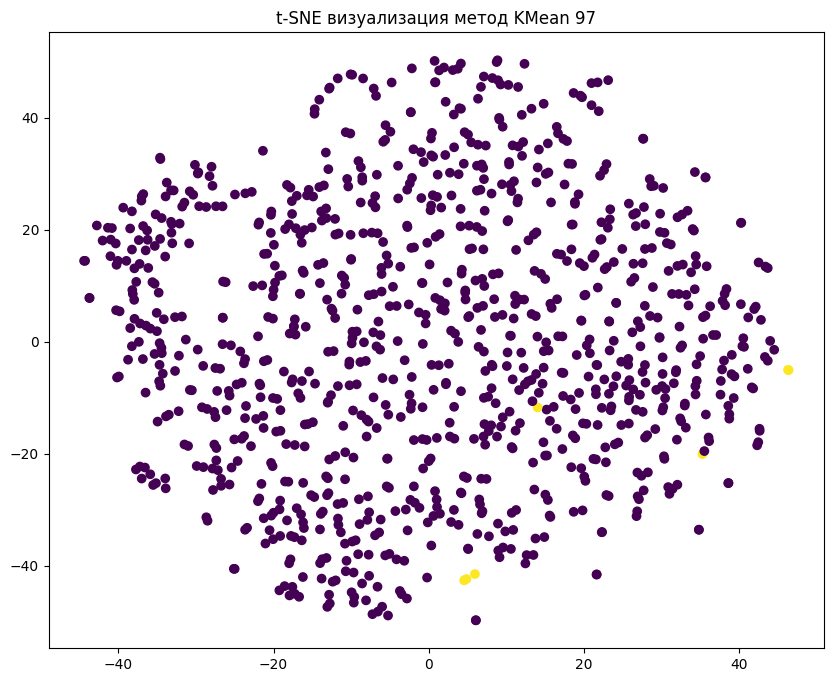

In [67]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
ratings_tsne = tsne.fit_transform(normilized_ratings)
for i in range(best_k):
  plt.figure(figsize=(10, 8))
  plt.scatter(ratings_tsne[:, 0], ratings_tsne[:, 1], c=(labels == i))
  plt.title(f't-SNE визуализация метод KMean {i}')
  plt.show()

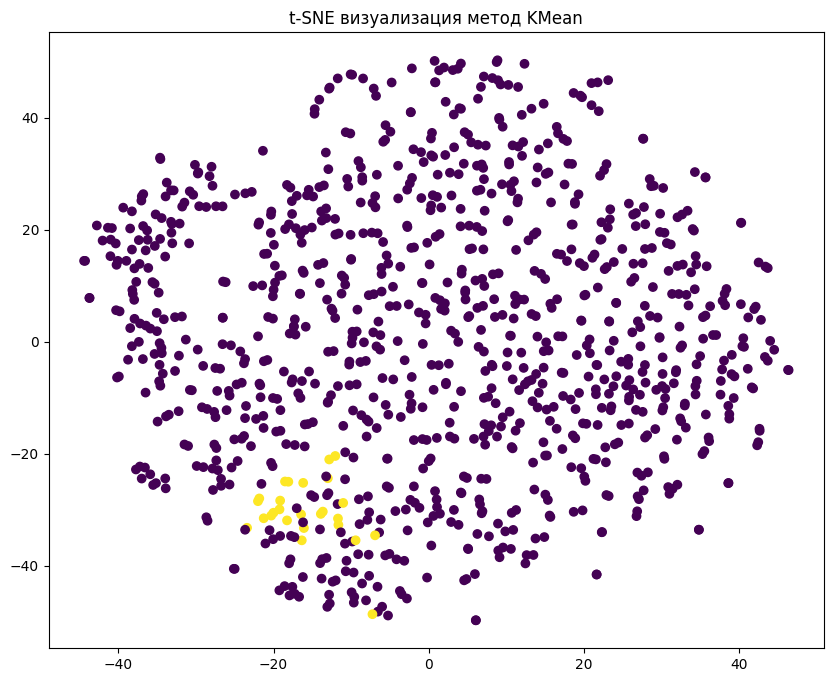

In [69]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
ratings_tsne = tsne.fit_transform(normilized_ratings)

plt.figure(figsize=(10, 8))
plt.scatter(ratings_tsne[:, 0], ratings_tsne[:, 1], c=(labels == 49))
plt.title('t-SNE визуализация метод KMean')
plt.show()

**Ответ:** 49 кластер в сравнении с остальными неплохо отражен, видно, что объекты близко друг к другу в кучке